In [1]:
# Iman Wahle, Jenna Kahn
# # Created March 9, 2021
# This notebook demonstrates how to compare clustering methods on multiple datasets

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
import compare
import warnings
from tensorflow.keras.datasets import mnist
from sklearn.manifold import TSNE

In [3]:
# paths
base_path = '/Users/imanwahle/Desktop/cfl/cfl/cluster_methods/compare_methods'
DATA_PATH = os.path.join(base_path, 'data')
RESULTS_PATH = os.path.join(base_path, 'results')

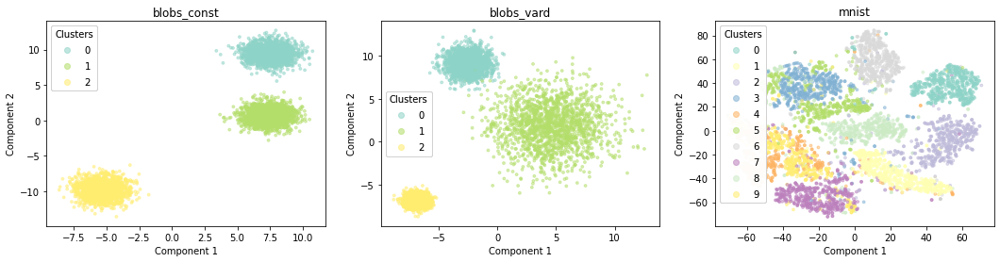

In [4]:
# first, we must package a few datasets in the appropriate format

# constants
n_samples = 5000
random_state = 42
data_names = ['blobs_const', 'blobs_vard', 'mnist']

# generate sklearn blob data
data0 = datasets.make_blobs(n_samples=n_samples, random_state=8)
data1 = datasets.make_blobs(n_samples=n_samples, cluster_std=[1.0, 2.5, 0.5],  random_state=random_state)

# let's also include some MNIST data for high dimensionality!
(train_X, train_y), (test_X, test_y) = mnist.load_data()
train_X = np.reshape(train_X, (train_X.shape[0], train_X.shape[1]*train_X.shape[2]))

# we only want n_samples points from mnist for now
idx = np.random.choice(range(train_X.shape[0]), n_samples)
data2 = [train_X[idx,:], train_y[idx,]]

# save in expected format
datas = [data0, data1, data2]

for dataset,data_name in zip(datas, data_names):
    os.mkdir(os.path.join(DATA_PATH, data_name))
    np.save(os.path.join(DATA_PATH, data_name, 'data_to_cluster.npy'), dataset[0])
    np.save(os.path.join(DATA_PATH, data_name, 'true_labels.npy'), dataset[1])

# visualize data
fig,axs = plt.subplots(1, len(datas), figsize=(len(datas)*6,4))
for dataset,data_name,ax in zip(datas, data_names, axs.ravel()):

    # get embedding
    if dataset[0].shape[1] > 2:
        embedding = compare.get_embedding(DATA_PATH, data_name)
    else:
        embedding = dataset[0]
    
    # make subplot
    compare.scatter_helper(ax, embedding, dataset[1], data_name, subscript=None)

plt.show()

In [5]:
# setup arguments for comparison
data_path_list = data_names
method_list = ['KMeans', 'DBSCAN', 'AgglomerativeClustering', 'SpectralClustering']
params = [  {'n_clusters' : (1,9,8)}, 
            {'eps' : (1.0, 2.0, 9), 'min_samples' : (1,6,5)},
            {'n_clusters' : (1,9,8)},
            {'n_clusters' : (1,9,8)}]


DATASET: blobs_const, METHOD: KMeans


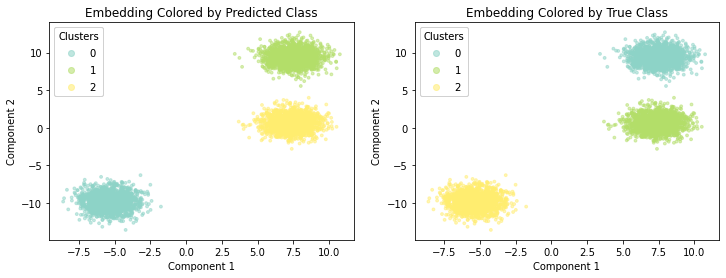

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'n_clusters': 3}

DATASET: blobs_const, METHOD: DBSCAN


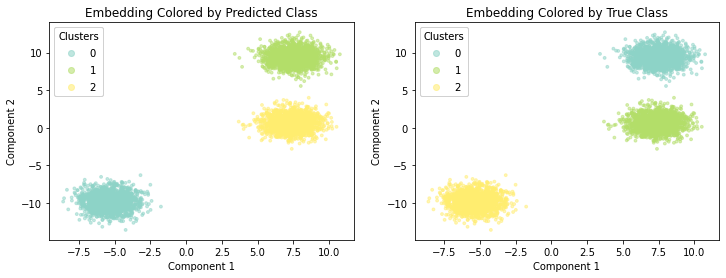

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'eps': 1.25, 'min_samples': 1}

DATASET: blobs_const, METHOD: AgglomerativeClustering


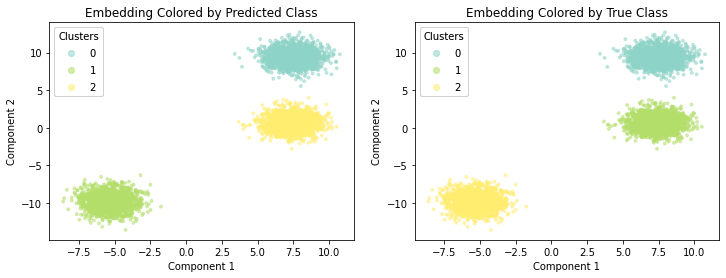

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'n_clusters': 3}

DATASET: blobs_const, METHOD: SpectralClustering


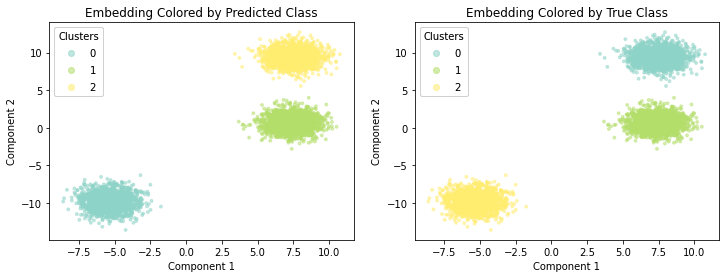

best ground-truth score: 1.0
best cluster-goodness score: 0.8288037380395461
best params {'n_clusters': 3}

DATASET: blobs_vard, METHOD: KMeans


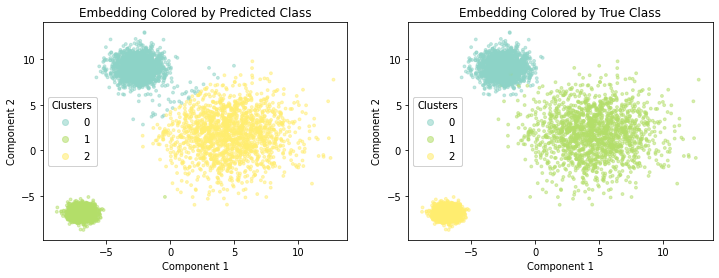

best ground-truth score: 0.9626614579748362
best cluster-goodness score: 0.7731938855536118
best params {'n_clusters': 3}

DATASET: blobs_vard, METHOD: DBSCAN


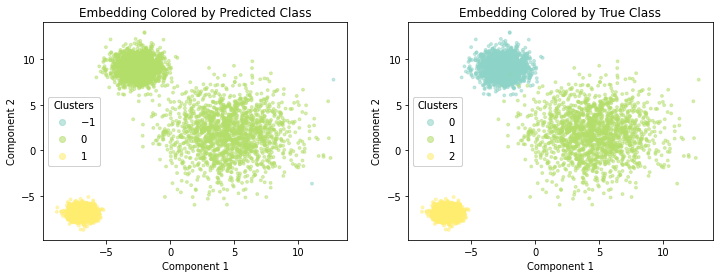

best ground-truth score: 0.7323710206780718
best cluster-goodness score: 0.5824657483303859
best params {'eps': 1.875, 'min_samples': 2}

DATASET: blobs_vard, METHOD: AgglomerativeClustering


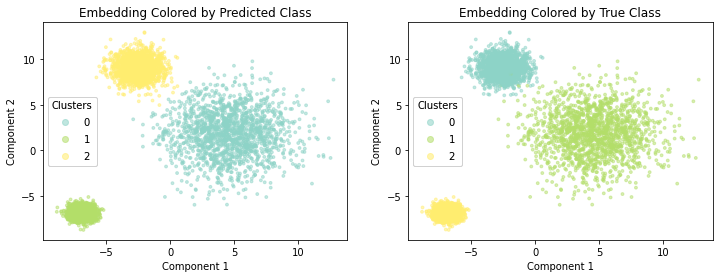

best ground-truth score: 0.9879385587647908
best cluster-goodness score: 0.7722708134333838
best params {'n_clusters': 3}

DATASET: blobs_vard, METHOD: SpectralClustering


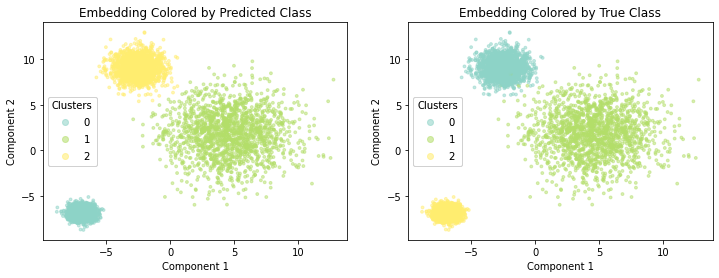

best ground-truth score: 0.9888614893925656
best cluster-goodness score: 0.7721580733555093
best params {'n_clusters': 3}

DATASET: mnist, METHOD: KMeans


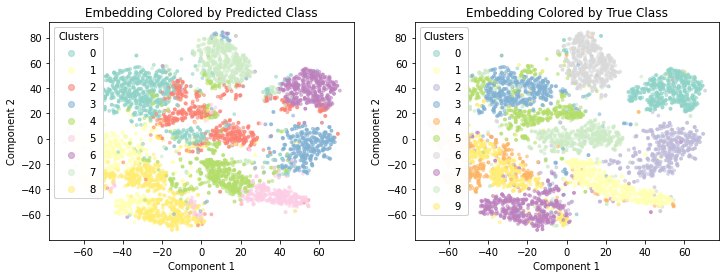

best ground-truth score: 0.4879934679224374
best cluster-goodness score: 0.057876578974837604
best params {'n_clusters': 9}

DATASET: mnist, METHOD: DBSCAN


In [6]:
# run comparison
with warnings.catch_warnings(): # warnings from CFL make things messy right now
    warnings.simplefilter("ignore")
    compare.main(DATA_PATH, data_path_list, method_list, params, RESULTS_PATH)

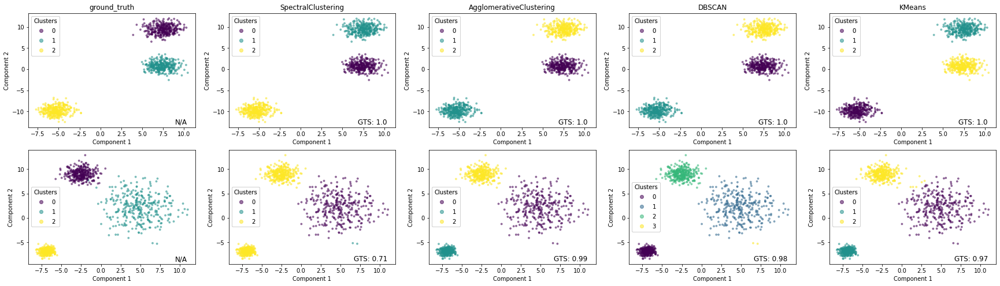

In [102]:
from importlib import reload
reload(compare)
compare.compare_scatter_plots(DATA_PATH, RESULTS_PATH, subfigsize=(6,4))